In [1]:
import matplotlib.pyplot as plt
import os, json, sys
import numpy as np

file = "./stats/training_stats_epoch_32.json"

with open(file, "r") as f:
    data = json.load(f)

data.keys()

dict_keys(['train_loss', 'train_acc', 'test_acc', 'test_loss'])

In [2]:
train_loss, train_acc, test_acc, test_loss = data["train_loss"], data["train_acc"], data["test_acc"], data["test_loss"]

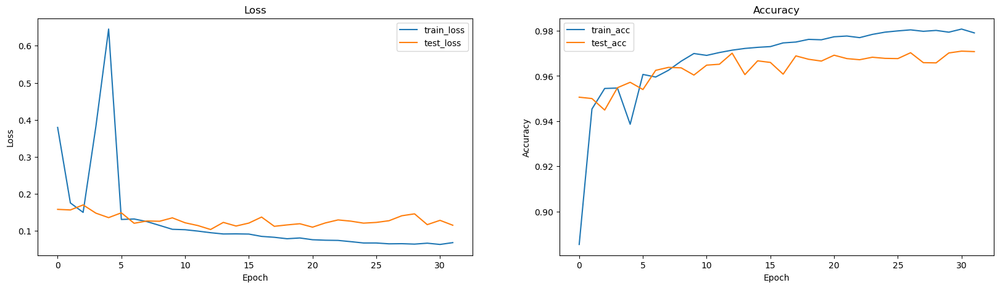

In [3]:
# make a 2x2 plot of data
fig, axs = plt.subplots(1, 2, figsize=(20, 5))

for keys in data.keys():
    if "loss" in keys:
        axs[0].plot(data[keys], label=keys)
        axs[0].set_title("Loss")
        axs[0].set_xlabel("Epoch")
        axs[0].set_ylabel("Loss")
        axs[0].legend()
    elif "acc" in keys:
        axs[1].plot(data[keys], label=keys)
        axs[1].set_title("Accuracy")
        axs[1].set_xlabel("Epoch")
        axs[1].set_ylabel("Accuracy")
        axs[1].legend()

In [4]:
# lets test the model
from conv_nets import NMNISTFORPLOTTING
import torch

model = NMNISTFORPLOTTING()
#load the weights
checkpoint = torch.load("./weights/nmnistv2_epoch32.pth", map_location=torch.device("cuda"))
model.load_state_dict(checkpoint["model_state_dict"])
model.eval()

C:\Users\alext\AppData\Local\Temp\ipykernel_24812\1138686577.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./weights/nmnistv2_epoch32.pth", ma

NMNISTFORPLOTTING(
  (conv1): Conv2d(1, 12, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(12, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (fmap1): FeatureMapNeuronLayer()
  (fmap2): FeatureMapNeuronLayer()
  (pool1): SumPooling2D()
  (pool2): SumPooling2D()
  (fc): Linear(in_features=1536, out_features=10, bias=True)
)

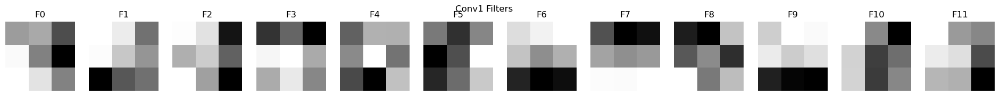

In [5]:
filters = model.conv1.weight.data.cpu().numpy()  # Shape: [out_channels, in_channels, k, k]

num_filters = filters.shape[0]
fig, axes = plt.subplots(1, num_filters, figsize=(num_filters * 2, 2))
for i in range(num_filters):
    # Assuming in_channels = 1, squeeze to 2D
    filter_img = filters[i, 0]
    ax = axes[i] if num_filters > 1 else axes
    ax.imshow(filter_img, cmap='gray')
    ax.axis('off')
    ax.set_title(f"F{i}")
plt.suptitle("Conv1 Filters")
plt.show()

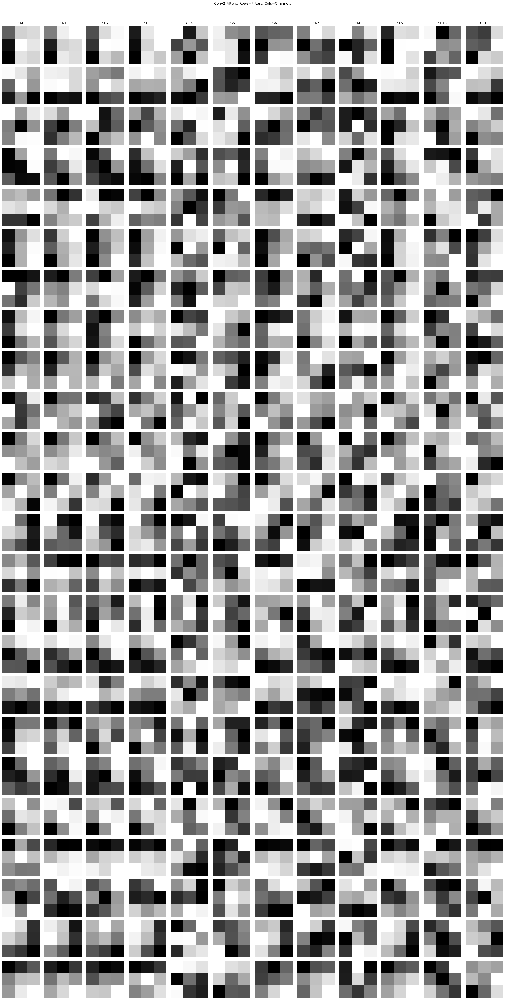

In [6]:
import matplotlib.pyplot as plt

# Shape: [out_channels, in_channels, k, k]
filters2 = model.conv2.weight.data.cpu().numpy()
out_channels, in_channels, k, _ = filters2.shape

fig, axes = plt.subplots(out_channels, in_channels, figsize=(in_channels * 2, out_channels * 2))

for i in range(out_channels):      # each filter (row)
    for j in range(in_channels):   # each input channel (col)
        ax = axes[i, j] if out_channels > 1 and in_channels > 1 else axes[max(i, j)]
        ax.imshow(filters2[i, j], cmap='gray')
        ax.axis('off')
        if i == 0:
            ax.set_title(f"Ch{j}")
        if j == 0:
            ax.set_ylabel(f"F{i}")

plt.suptitle("Conv2 Filters: Rows=Filters, Cols=Channels")
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


In [ ]:
# load dataset 
from tonic.datasets import NMNIST
import tonic
import tonic.transforms as tonic_transforms
time_bin_width_us = 1000  # 1ms
sensor_size = tonic.datasets.NMNIST.sensor_size
data_path = "./data/nmnist"
class OnlyPositive(object):
    def __call__(self, frames):
        # Input: frames [T, 2, H, W] (polarity in dim=1)
        # Output: only positive polarity (assumes polarity index 1 is positive in tonic NMNIST)
        return frames[:, 1:2, :, :]

frame_transform = tonic_transforms.Compose([
    tonic_transforms.ToFrame(sensor_size=sensor_size, time_window=time_bin_width_us),
    OnlyPositive()
])
testset = tonic.datasets.NMNIST(save_to=data_path, transform=frame_transform, train=False)

# plot first sample as an animation


In [34]:
frames, target = testset[5867]
target

5

In [35]:
import torch
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Fetch a sample from your dataset (as before)
frames, target = testset[5867]        # [T, 1, H, W]
frames = torch.from_numpy(frames).float().squeeze(1)  # [T, H, W]
T, H, W = frames.shape

fig, ax = plt.subplots()
vmin, vmax = frames.min().item(), frames.max().item()
im = ax.imshow(frames[0], cmap='gray', vmin=vmin, vmax=vmax)
ax.set_title(f"NMNIST Sample 0 (Label: {target})")

def update(i):
    im.set_data(frames[i])
    ax.set_xlabel(f"Frame {i+1}/{T}")
    return [im]

ani = animation.FuncAnimation(fig, update, frames=T, interval=100, blit=True)

# --- This is the key part for inline animation in Jupyter ---
html_anim = HTML(ani.to_jshtml())
plt.close(fig)  # Prevents double image in Jupyter
display(html_anim)


In [25]:
model = NMNISTFORPLOTTING()   # or however you instantiate
model.load_state_dict(checkpoint["model_state_dict"])
model = model.to("cuda") 

In [42]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display
sample_idx = 5867
frames, target = testset[sample_idx]
frames = torch.from_numpy(frames).float()  # [T, 1, H, W]
input_frames = frames.squeeze(1)           # [T, H, W]
frames_cuda = frames.unsqueeze(0).to(device)  # [1, T, 1, H, W]
with torch.no_grad():
    output, mem1_traj, mem2_traj = model(frames_cuda, return_features=True)
feature_maps = mem1_traj[:, 0].cpu()          # [T, 12, H, W]
frames_cuda = frames.unsqueeze(0).to(device)  # [1, T, 1, H, W]
with torch.no_grad():
    output, mem1_traj, mem2_traj = model(frames_cuda, return_features=True)
feature_maps = mem1_traj[:, 0].cpu()          # [T, 12, H, W]

T, H, W = input_frames.shape
fig = plt.figure(figsize=(14, 8))
gs = fig.add_gridspec(3, 5, width_ratios=[2.5, 1, 1, 1, 1], wspace=0.2, hspace=0.2)

# Input image
ax_img = fig.add_subplot(gs[:, 0])
im_input = ax_img.imshow(input_frames[0], cmap='gray', vmin=input_frames.min(), vmax=input_frames.max())
ax_img.set_title("Input Frame")
ax_img.axis('off')

# Feature maps
ims_feat = []
for i in range(12):
    row = i // 4
    col = i % 4 + 1
    ax = fig.add_subplot(gs[row, col])
    # Fix color scale for all frames for consistent visualization
    im = ax.imshow(feature_maps[0, i], cmap='viridis', vmin=feature_maps.min(), vmax=feature_maps.max())
    ax.set_title(f"FM {i+1}")
    ax.axis('off')
    ims_feat.append(im)

def update(t):
    im_input.set_data(input_frames[t])
    for i in range(12):
        ims_feat[i].set_data(feature_maps[t, i])
    fig.suptitle(f"Time step: {t+1}/{T}", fontsize=16)
    return [im_input] + ims_feat

ani = animation.FuncAnimation(fig, update, frames=list(range(T)), interval=150, blit=True)

plt.close(fig)
display(HTML(ani.to_jshtml()))


In [29]:
desired_fps = 25
interval = int(1000 / desired_fps)

ani = animation.FuncAnimation(fig, update, frames=T, interval=interval, blit=True)
ani.save("feature_maps.gif", writer='imagemagick')


MovieWriter imagemagick unavailable; using Pillow instead.
